In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
cd /content/drive/My Drive/Bengali_db

/content/drive/My Drive/Bengali_db


In [0]:
cp latest.zip /content

In [0]:
cd /content

/content


In [0]:
ls

drive/  latest.zip  sample_data/


In [0]:
!unzip latest.zip

Archive:  latest.zip
   creating: latest/
   creating: latest/test/
   creating: latest/test/Bengali Male/
  inflating: latest/test/Bengali Male/Page-402.jpg  
  inflating: latest/test/Bengali Male/0aeb845b3457a06289088f8539b86da8.jpg  
  inflating: latest/test/Bengali Male/020818rohingya1_960x540.jpg  
  inflating: latest/test/Bengali Male/06913532.jpg  
  inflating: latest/test/Bengali Male/07031825.jpg  
  inflating: latest/test/Bengali Male/0904ba717d515624cc86c333f161b8c7.jpeg  
  inflating: latest/test/Bengali Male/1-6YV5c_iMw2F-0gy2zhGaFA.jpeg  
  inflating: latest/test/Bengali Male/1-CNABvH3AnAao_s-hZ7aqPg.jpeg  
  inflating: latest/test/Bengali Male/10422376_500635230073070_7226617105676830799_n_2.jpg  
  inflating: latest/test/Bengali Male/113045.jpg  
  inflating: latest/test/Bengali Male/11455432.jpg  
  inflating: latest/test/Bengali Male/11631934574_d9371e1113_b.jpg  
  inflating: latest/test/Bengali Male/118572_2.jpg  
  inflating: latest/test/Bengali Male/1200px-Adil_Ho

In [0]:
ls

drive/  latest/  latest.zip  sample_data/


In [0]:
cd latest

/content/latest


In [0]:
ls

test/  train/


In [0]:
pwd

'/content/latest'

In [0]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from __future__ import print_function
import keras
from keras.preprocessing.image import ImageDataGenerator, load_img


Using TensorFlow backend.


In [0]:
train_dir = 'train'
validation_dir = 'test'
image_size = 224

In [0]:

# Experiment 1: Freezing all layers - Same as Transfer Learning

# Create the model




from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(2, activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

W0811 18:52:08.368417 140452583991168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0811 18:52:08.416690 140452583991168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0811 18:52:08.424381 140452583991168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0811 18:52:08.464232 140452583991168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.



58892288/58889256 [==============================] - 2s 0us/step


W0811 18:52:11.324932 140452583991168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0811 18:52:11.325936 140452583991168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:181: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W0811 18:52:14.935063 140452583991168 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3445: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


<keras.engine.input_layer.InputLayer object at 0x7fbd5f88d6a0> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5f88d908> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5f88d828> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbd5f8a6be0> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5f8a63c8> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5f04fba8> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbd5f05fbe0> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5f05f240> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5f013748> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5efaf9e8> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbd5efbf828> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5efbf5c0> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5ef71b00> False
<keras.layers.convolutional.Conv2D object at 0x7fbd5ef88d68> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbd5ef9ca20>

W0811 18:53:15.309101 140452583991168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



Found 3345 images belonging to 2 classes.
Found 838 images belonging to 2 classes.


W0811 18:53:15.417103 140452583991168 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Epoch 1/20
13/33 [==========>...................] - ETA: 45s - loss: 6.8891 - acc: 0.5054

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:2496: DecompressionBombWarning: Image size (139489119 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)


25/33 [=====================>........] - ETA: 18s - loss: 7.5796 - acc: 0.4948

/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 33685504 bytes but only got 0. Skipping tag 4
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 47185920 bytes but only got 0. Skipping tag 4
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 65536 bytes but only got 0. Skipping tag 3
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 2359296 bytes but only got 0. Skipping tag 5
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to re

34/33 [==============================] - 95s 3s/step - loss: 7.5585 - acc: 0.4926 - val_loss: 2.9693 - val_acc: 0.5012
Epoch 2/20
34/33 [==============================] - 70s 2s/step - loss: 0.8257 - acc: 0.6336 - val_loss: 0.4331 - val_acc: 0.8222
Epoch 3/20
34/33 [==============================] - 73s 2s/step - loss: 0.5833 - acc: 0.7100 - val_loss: 0.5618 - val_acc: 0.6718
Epoch 4/20
34/33 [==============================] - 73s 2s/step - loss: 0.4757 - acc: 0.7611 - val_loss: 0.3970 - val_acc: 0.8222
Epoch 5/20
34/33 [==============================] - 73s 2s/step - loss: 0.3930 - acc: 0.8249 - val_loss: 0.4602 - val_acc: 0.7721
Epoch 6/20
34/33 [==============================] - 73s 2s/step - loss: 0.3682 - acc: 0.8288 - val_loss: 0.3437 - val_acc: 0.8580
Epoch 7/20
34/33 [==============================] - 72s 2s/step - loss: 0.3129 - acc: 0.8641 - val_loss: 0.3243 - val_acc: 0.8640
Epoch 8/20
34/33 [==============================] - 72s 2s/step - loss: 0.2850 - acc: 0.8709 - val_lo

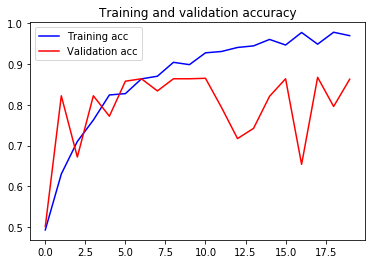

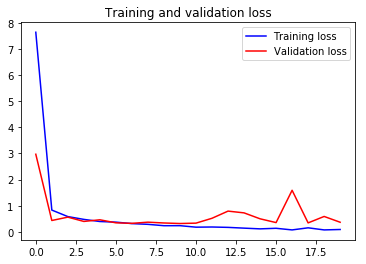

In [0]:

# Experiment 1

# Train the model


# No Data augmentation 
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
history = model.fit_generator(
      train_generator,
      steps_per_epoch=train_generator.samples/train_generator.batch_size ,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('all_freezed.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()



Found 838 images belonging to 2 classes.
84/83 [==============================] - 14s 163ms/step
No of errors = 115/838


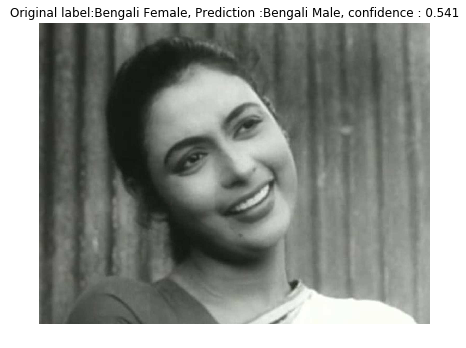

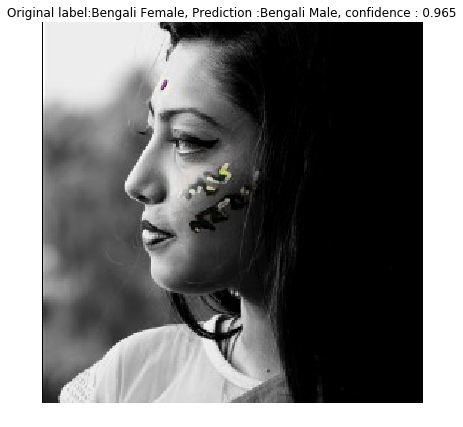

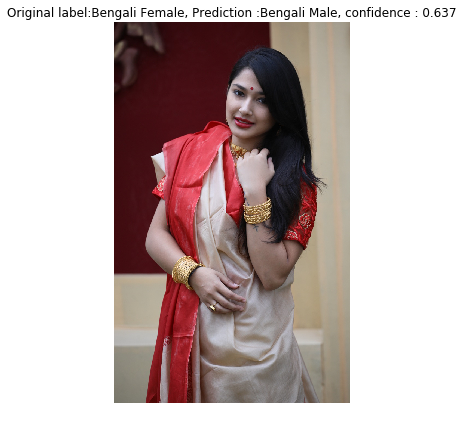

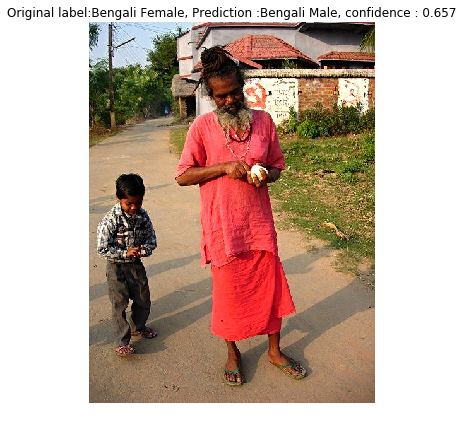

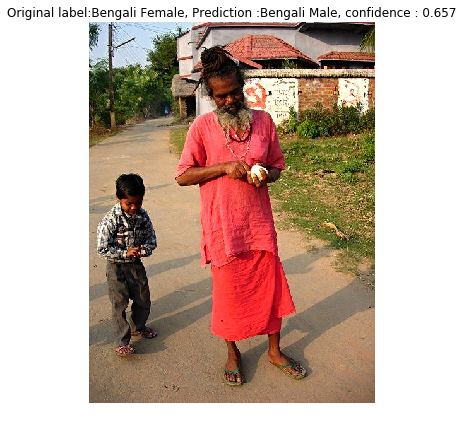

...

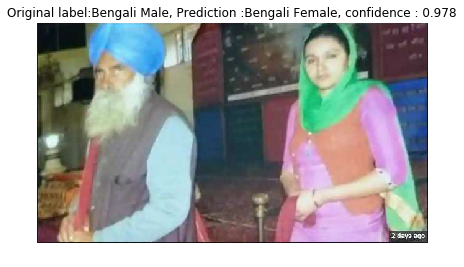

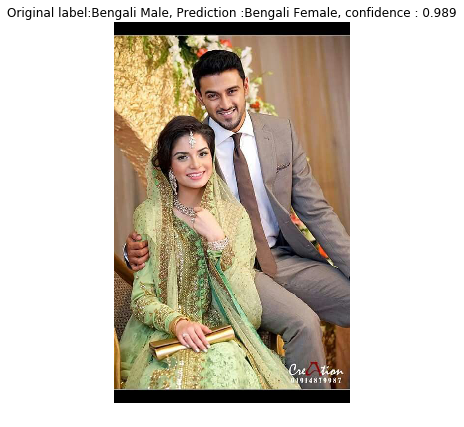

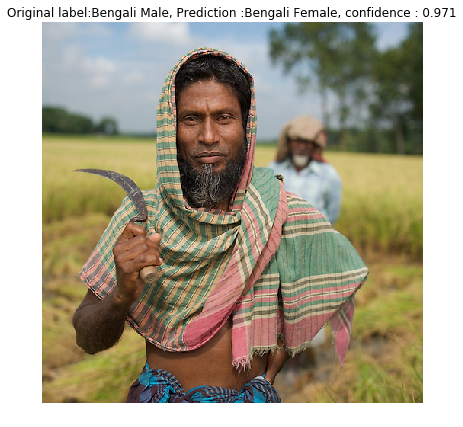

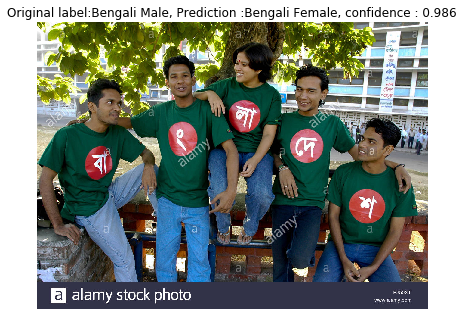

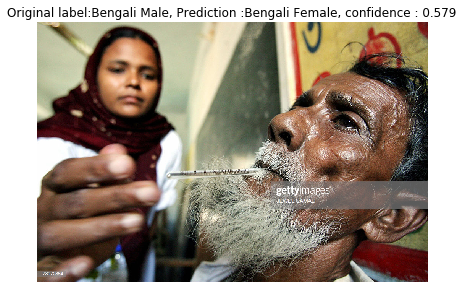

In [0]:

# Experiment 1

# Show the errors


# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()


In [0]:
# Experiment 2 : Train Last 4 layers without data augmentation


from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:-4]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(2, activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

<keras.engine.input_layer.InputLayer object at 0x7fbd0442a828> False
<keras.layers.convolutional.Conv2D object at 0x7fbd0442a400> False
<keras.layers.convolutional.Conv2D object at 0x7fbd04444208> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbd0444ff60> False
<keras.layers.convolutional.Conv2D object at 0x7fbd04067ef0> False
<keras.layers.convolutional.Conv2D object at 0x7fbd04962198> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbd0492fcc0> False
<keras.layers.convolutional.Conv2D object at 0x7fbd0492f978> False
<keras.layers.convolutional.Conv2D object at 0x7fbcea6d9b70> False
<keras.layers.convolutional.Conv2D object at 0x7fbd0406df98> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbcea737ac8> False
<keras.layers.convolutional.Conv2D object at 0x7fbcea6d0908> False
<keras.layers.convolutional.Conv2D object at 0x7fbcea7becf8> False
<keras.layers.convolutional.Conv2D object at 0x7fbcea7f1b38> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbd0420f128>

Found 3345 images belonging to 2 classes.
Found 838 images belonging to 2 classes.
Epoch 1/20
 4/33 [==>...........................] - ETA: 59s - loss: 2.7239 - acc: 0.5100 

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:2496: DecompressionBombWarning: Image size (139489119 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)


31/33 [==========================>...] - ETA: 4s - loss: 1.0143 - acc: 0.5455

/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 33685504 bytes but only got 0. Skipping tag 4
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 47185920 bytes but only got 0. Skipping tag 4
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 65536 bytes but only got 0. Skipping tag 3
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 2359296 bytes but only got 0. Skipping tag 5
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to re

34/33 [==============================] - 86s 3s/step - loss: 0.9821 - acc: 0.5515 - val_loss: 0.9860 - val_acc: 0.5036
Epoch 2/20
34/33 [==============================] - 72s 2s/step - loss: 0.5512 - acc: 0.7332 - val_loss: 0.8311 - val_acc: 0.6229
Epoch 3/20
34/33 [==============================] - 72s 2s/step - loss: 0.3974 - acc: 0.8166 - val_loss: 0.3664 - val_acc: 0.8401
Epoch 4/20
34/33 [==============================] - 72s 2s/step - loss: 0.2939 - acc: 0.8679 - val_loss: 1.2475 - val_acc: 0.5800
Epoch 5/20
34/33 [==============================] - 72s 2s/step - loss: 0.2668 - acc: 0.8990 - val_loss: 0.2762 - val_acc: 0.8866
Epoch 6/20
34/33 [==============================] - 71s 2s/step - loss: 0.1767 - acc: 0.9241 - val_loss: 0.4256 - val_acc: 0.8544
Epoch 7/20
34/33 [==============================] - 72s 2s/step - loss: 0.1214 - acc: 0.9543 - val_loss: 0.3445 - val_acc: 0.8759
Epoch 8/20
34/33 [==============================] - 72s 2s/step - loss: 0.0883 - acc: 0.9662 - val_lo

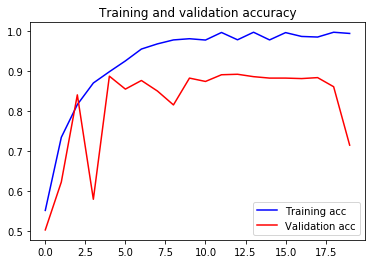

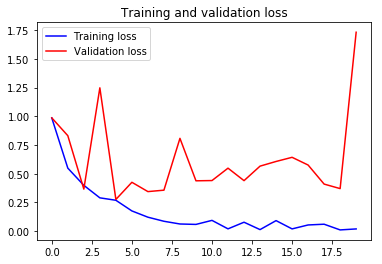

In [0]:

# Experiment 2

# Train the model


# No Data augmentation 
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
history = model.fit_generator(
      train_generator,
      steps_per_epoch=train_generator.samples/train_generator.batch_size ,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('last4_layers.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()


Found 838 images belonging to 2 classes.
84/83 [==============================] - 14s 165ms/step
No of errors = 239/838


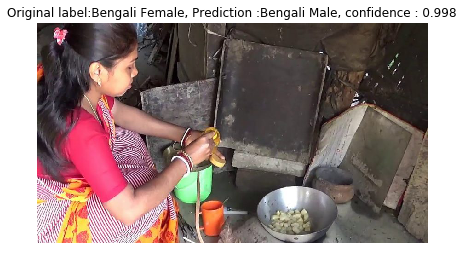

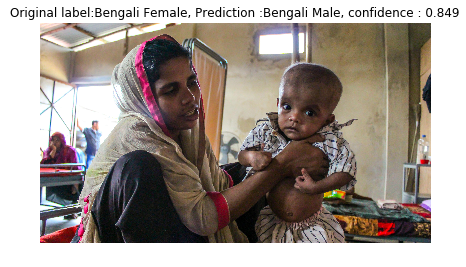

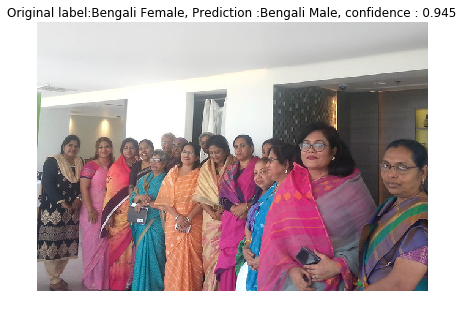

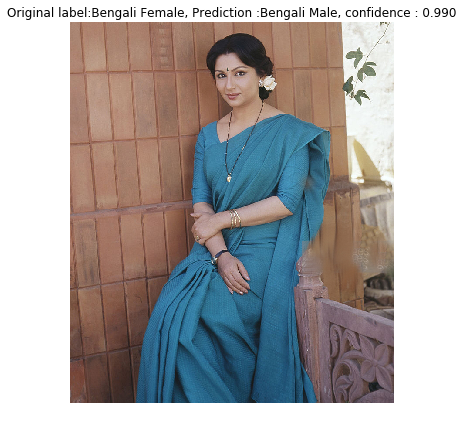

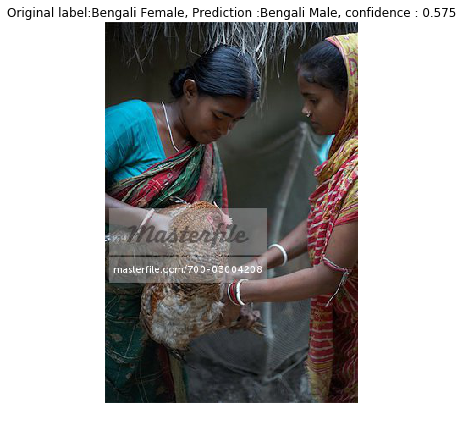

...

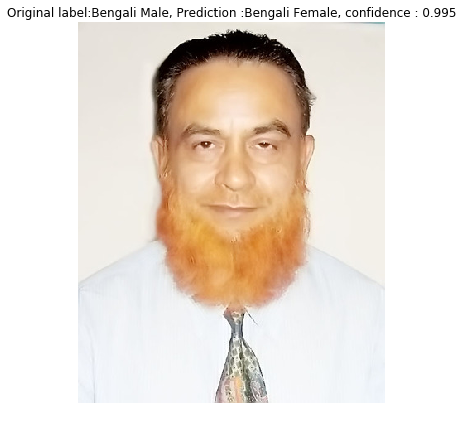

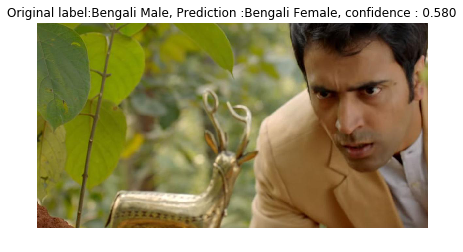

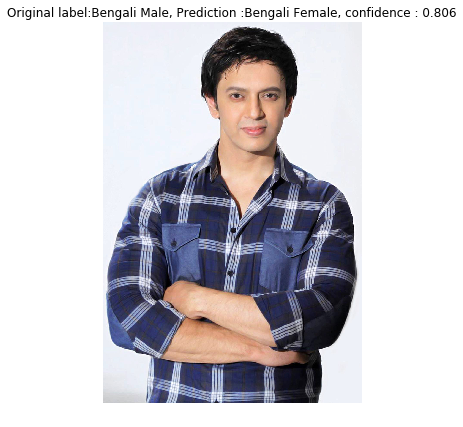

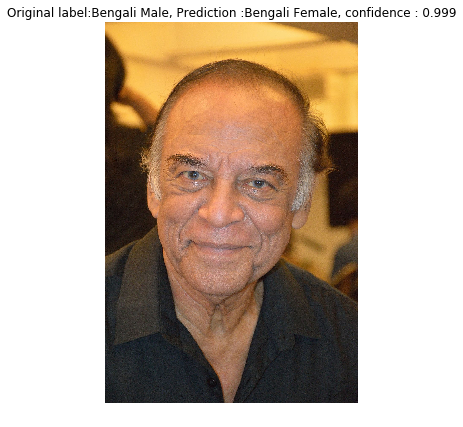

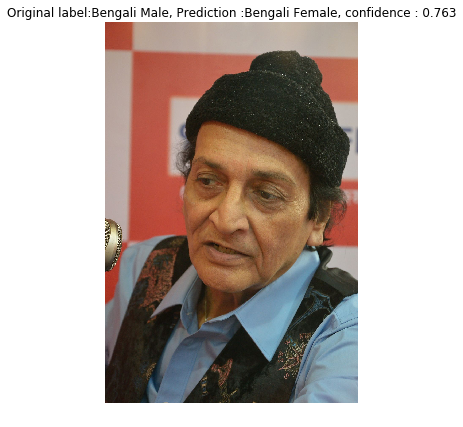

In [0]:

# Experiment 2

# Show the errors



# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()